# Import of libraries + Dataset

In [1]:
import pandas as pd
import numpy as np

from sklearn.model_selection import train_test_split
from sklearn.pipeline import Pipeline
from sklearn.impute import SimpleImputer, KNNImputer
from sklearn.preprocessing import  OneHotEncoder, StandardScaler
from sklearn.compose import ColumnTransformer
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestRegressor
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import GridSearchCV, cross_val_score
from sklearn.metrics import accuracy_score, f1_score, ConfusionMatrixDisplay, RocCurveDisplay, classification_report, confusion_matrix

import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objects as go
import plotly.io as pio
import seaborn as sns

import warnings
warnings.filterwarnings("ignore", category=DeprecationWarning)

from IPython.display import display

In [2]:
dataset = pd.read_csv('conversion_data_train.csv')

# Data Visualization

In [3]:
print("Number of rows : {}".format(dataset.shape[0]))
print("Number of columns : {}".format(dataset.shape[1]))
print()

print("Display of dataset: ")
display(dataset.head())
print()

print("Basics statistics: ")
data_desc = dataset.describe(include='all')
display(data_desc)
print()

print("Percentage of missing values: ")
display(100*dataset.isnull().sum()/dataset.shape[0])

Number of rows : 284580
Number of columns : 6

Display of dataset: 


,country,age,new_user,source,total_pages_visited,converted
0,China,22,1,Direct,2,0
1,UK,21,1,Ads,3,0
2,Germany,20,0,Seo,14,1
3,US,23,1,Seo,3,0
4,US,28,1,Direct,3,0



Basics statistics: 


,country,age,new_user,source,total_pages_visited,converted
count,284580,284580.000000,284580.000000,284580,284580.000000,284580.000000
unique,4,NaN,NaN,3,NaN,NaN
top,US,NaN,NaN,Seo,NaN,NaN
freq,160124,NaN,NaN,139477,NaN,NaN
mean,NaN,30.564203,0.685452,NaN,4.873252,0.032258
std,NaN,8.266789,0.464336,NaN,3.341995,0.176685
min,NaN,17.000000,0.000000,NaN,1.000000,0.000000
25%,NaN,24.000000,0.000000,NaN,2.000000,0.000000
50%,NaN,30.000000,1.000000,NaN,4.000000,0.000000
75%,NaN,36.000000,1.000000,NaN,7.000000,0.000000



Percentage of missing values: 


country                0.0
age                    0.0
new_user               0.0
source                 0.0
total_pages_visited    0.0
converted              0.0
dtype: float64

In [4]:
dataset[dataset["age"] > 100]

,country,age,new_user,source,total_pages_visited,converted
11331,UK,111,0,Ads,10,1
233196,Germany,123,0,Seo,15,1


In [5]:
# Removing lines with age value over 100, probably a mistake
dataset = dataset[dataset["age"] < 100]

In [6]:
# Checking the proportion of conversion on the sample
labels = {0:'no', 1:'converted'}
dataset['converted_TEXT'] = dataset['converted'].map(labels)

fig = px.pie(dataset, names="converted_TEXT", title = "Conversion Ratio",color="converted_TEXT",color_discrete_map={'no':'#FF9933','converted':'#66CC00'})
fig.update_layout(title_x=0.48)
fig.show()

As we see an imbalanced dataset, we know we will not be able to evakuate performance with accuracy. We will need to use F1 score.

In [7]:
# As the dataset is quite big, we will make some visualisations only on a sample :
data_sample = dataset.sample(20000)

In [8]:
# Univariate analysis
# # Distribution of each numeric variable
num_features = ['age', 'total_pages_visited']
for i in range(len(num_features)):
    fig = px.histogram(data_sample[num_features[i]])
    fig.show()

In [9]:
# Univariate analysis
# Barplot of each qualitative variable
cat_features = ['country','new_user', 'source']
for i in range(len(cat_features)):
    fig = px.histogram(data_sample[cat_features[i]])
    fig.show()

In [10]:
# feature engineering on age
dataset['age_status']= dataset['age'].apply(lambda x: 'not adult' if x < 21 else
                                                        'adult' if x < 50 else 'old')

In [11]:
# feature engineering on number of pages visited
dataset['total_pages_visited_square'] = dataset['total_pages_visited'] **2
dataset['total_pages_visited_cube'] = dataset['total_pages_visited'] **3
dataset['total_pages_visited_inverse'] = 1/dataset['total_pages_visited']

In [12]:
# Correlation matrix
corr_matrix = dataset.corr().round(2)

import plotly.figure_factory as ff

fig = ff.create_annotated_heatmap(corr_matrix.values,
                                  x = corr_matrix.columns.tolist(),
                                  y = corr_matrix.index.tolist(), )

fig.update_layout(title = go.layout.Title(text = 'Correlation matrix', y =0.9), width=700, height=500, margin=dict(l=150, r=150, t=80, b=20)),
fig.show()

# Preprocessing

In [13]:
# Separating target variable Y from features X
features_list = ['country', 'age', 'new_user', 'source', 'total_pages_visited','age_status', 'total_pages_visited_square','total_pages_visited_cube', 'total_pages_visited_inverse']
target_variable = "converted"

X = dataset.loc[:,features_list]
Y = dataset.loc[:,target_variable]

In [14]:
# Dividing dataset Train set & Test set 
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=0, stratify = Y)

In [15]:
# Separating numeric from categorical features
numeric_features = ['age','total_pages_visited', 'total_pages_visited_square','total_pages_visited_cube', 'total_pages_visited_inverse']
categorical_features = ['country','new_user', 'source','age_status']

In [16]:
# Create pipeline for numeric features
numeric_transformer = Pipeline(steps=[('imputer', SimpleImputer(strategy='median')), # no missing value on our dataset, but we might have some on new data to analyze
                                        ('scaler', StandardScaler())])

# Create pipeline for categorical features
categorical_transformer = Pipeline(steps=[('imputer', SimpleImputer(strategy='most_frequent')),
                                            ('encoder', OneHotEncoder(drop='first'))])

# Use ColumnTransformer to make a preprocessor object that describes all the treatments to be done
preprocessor = ColumnTransformer(
    transformers=[
        ('num', numeric_transformer, numeric_features),
        ('cat', categorical_transformer, categorical_features)
    ])                                        

In [19]:
# Preprocessings on train set and test set
X_train = preprocessor.fit_transform(X_train)
X_test = preprocessor.transform(X_test)

# Model 1: Logistic Regression

In [20]:
log_reg = LogisticRegression()
log_reg.fit(X_train, Y_train)

LogisticRegression()

By default the penalty of the model is L2-Ridge, which will lower some coefficients to avoid overfitting.

In [21]:
# Predictions on training set and on test set (to be able to evaluate with F1_score afterwards)
Y_train_pred = log_reg.predict(X_train)
Y_test_pred = log_reg.predict(X_test)

print("f1-score on training set : ", f1_score(Y_train, Y_train_pred))
print("f1-score on test set : ", f1_score(Y_test, Y_test_pred))

f1-score on training set :  0.7631439594523035
f1-score on test set :  0.763592670471613


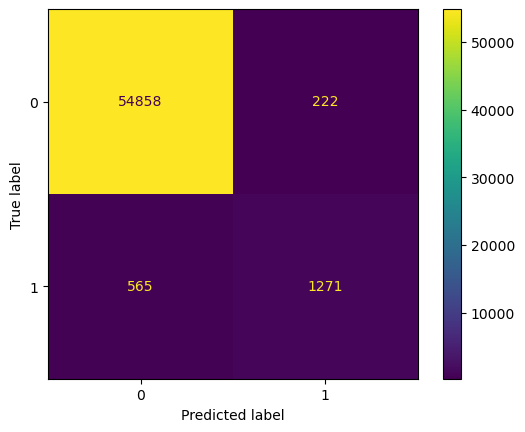

In [22]:
# Visualizing confusion matrix on test set
ConfusionMatrixDisplay.from_estimator(log_reg, X_test, Y_test)

In [23]:
# Extracting the names of the dummy variables created by OneHotEncoder
column_names = []
for name, pipeline, features_list in preprocessor.transformers_: # looping over pipelines
    if name == 'num': # if pipeline is for numeric variables
        features = features_list # just getting the names of columns to which it has been applied
    else: # if pipeline is for categorical variables
        features = pipeline.named_steps['encoder'].get_feature_names_out(categorical_features) # getting output columns names from OneHotEncoder
    column_names.extend(features) # concatenating features names
        
print("Names of columns corresponding to each coefficient: ", column_names)

Names of columns corresponding to each coefficient:  ['age', 'total_pages_visited', 'total_pages_visited_square', 'total_pages_visited_cube', 'total_pages_visited_inverse', 'country_Germany', 'country_UK', 'country_US', 'new_user_1', 'source_Direct', 'source_Seo', 'age_status_not adult', 'age_status_old']


In [24]:
# Creating a pandas DataFrame to plot the feature importance from our model
dataset_coefs = pd.DataFrame(index = column_names, data = log_reg.coef_.transpose(), columns=["coefficients"]).abs().sort_values(by = 'coefficients')

fig = px.bar(dataset_coefs, orientation = 'h',height=600)
fig.update_layout(showlegend = False, 
                  margin = {'l': 120}) # to avoid cropping of column names
fig.show()

<!-- We can see that the most important features for our model are the country and the number of pages visited.
As a way to increase the conversion rate, we could think of focusing on the number of pages visited. Trying to make people read more pages : for example recommending new articles at the bottom or the top of the page for the reader to click on it and follow on next pages. -->

We can see that the features most important for our model to make the predictions are the country of the user and the number of pages visited.

As a way of increasing the conversion rate, we could think of focusing on the number of pages visited. For example making recommendation articles at the bottom and and the top of the pages, so the user will be tempted to click on it and read a bit more.